In [2]:
import numpy as np
from matplotlib import gridspec as gridspec
from astropy.table import Table,Column
import random
from operator import itemgetter
from astropy.io import fits
import matplotlib.pyplot as plt
import bz2
import pdb
import warnings
import os
plt.rcParams['text.usetex']=True
plt.rcParams['xtick.labelsize'] = 25
plt.rcParams['ytick.labelsize'] = 25 
import Image,ImageOps
import urllib, cStringIO
%matplotlib inline
#function for getting galaxy images
def optical_image(gal):
    
    pixelsize=0.396
    height=424
    width=424

    #scale=.02*gal['PETROR90_R']/pixelsize/width
    scale = .02*gal['PETROR90_R']
    # form wurl to query SDSS web sevice to generate cutout image
    cutOutImageUrl="http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=" + str(gal['RA'])
    cutOutImageUrl += "&dec=" + str(gal['DEC']) + "&scale=""" + str(scale) + "&width=" + str(width)
    cutOutImageUrl += "&height=" + str(height)
    
    file = cStringIO.StringIO(urllib.urlopen(cutOutImageUrl).read())
    img = Image.open(file)    
    return img

def IR_image(gal):
    
    
    file = cStringIO.StringIO(urllib.urlopen(gal['UKIDSS_url']).read())
    img = Image.open(file)    
    #return img.crop((75, 75, 424-75, 424-75))
    return img

In [3]:
data = Table.read('data_SN.fits')
#r radii = 1000 if galaxy was on edge of frame, 2000 if S/N never dropped below 5, 0 if was always below 5

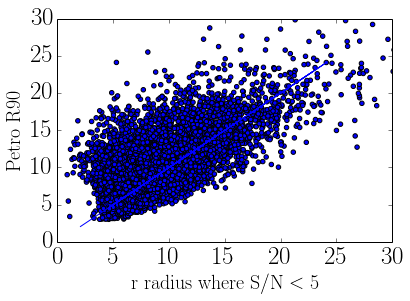

In [161]:
plt.scatter(data['RSN5_r'],data['PETROR90_R'])
plt.plot(data['RSN5_r'][0:50],data['RSN5_r'][0:50])
plt.xlim(0,30)
plt.ylim(0,30)
plt.xlabel('$\mathrm{r~radius~where~S/N < 5}$',fontsize=20)
plt.ylabel('$\mathrm{Petro~R90}$',fontsize=20)

In [162]:
len(data[data['RSN5_r']==1000])

991

In [163]:
np.mean(data[data['RSN5_r']<1000]['PETROR90_R']-data[data['RSN5_r']<1000]['RSN5_r'])

1.0901056151887063

### 991 galaxies didn't have S/N<5 radii measurements because the galaxy was on the edge of the sdss frame, preventing a proper cutout from being made. For these, approximate S/N < 5 radius with Petror90 + 1''. 

In [6]:
c_raw=Column([float(j)/r for j,r in zip(data['RSN5_j'],data['RSN5_r'])],name='J/r_raw')
c_corrected = Column([float(j)/r for j,r in zip(data['RSN5_j'],data['RSN5_r'])],name='J/r')
data.add_columns([c_raw,c_corrected])

In [7]:
for gal in data:
    if gal['RSN5_r']==1000: #change J/r to use petro instead of 1000
        gal['J/r']=gal['RSN5_j']/gal['PETROR90_R']

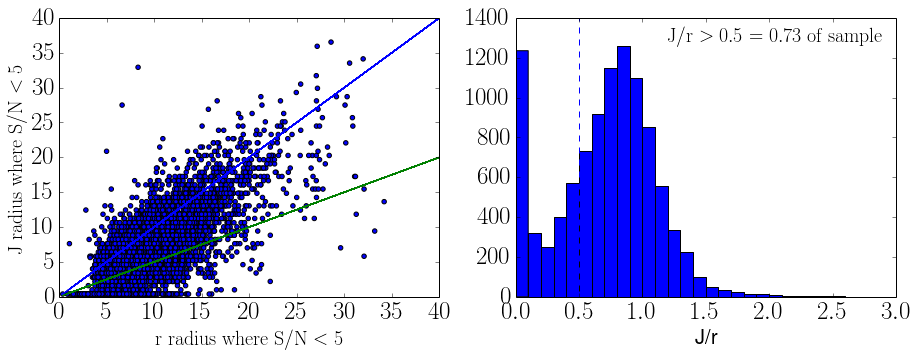

In [220]:
cut=.5
f=plt.figure(figsize=(15,5))
gs = gridspec.GridSpec(1,2)
ax=plt.subplot(gs[0,0])
plt.scatter(data['RSN5_r'],data['RSN5_j'])
plt.plot(data['RSN5_r'],data['RSN5_r'])
plt.plot(data['RSN5_r'],cut*data['RSN5_r'])
plt.xlabel('$\mathrm{r~radius~where~S/N < 5}$',fontsize=20)
plt.ylabel('$\mathrm{J~radius~where~S/N < 5}$',fontsize=20)
plt.xlim(0,40)
plt.ylim(0,40)
ax=plt.subplot(gs[0,1])
plt.hist(data['J/r'],range=(0,3),bins=30)
plt.xlabel('J/r',fontsize=20)
plt.axvline(cut,ls='dashed')
ax.annotate('$\mathrm{J/r>%s=%s~of~sample}$'%(round(cut,2),round(len(data[data['J/r']>cut])*1./len(data),2)),fontsize=20,xy=(0.4,.97),
    xycoords='axes fraction',verticalalignment='top')


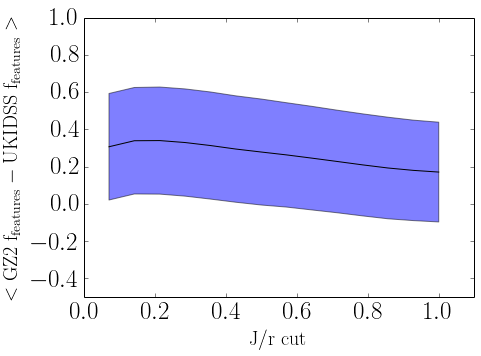

In [271]:
u_features = 't00_smooth_or_features_a1_features_debiased_rh_ukidss'
g_features = 't01_smooth_or_features_a02_features_or_disk_debiased_gz2'

Jr=np.linspace(0,1,15)
avg=[]
err = []
for x in Jr:
    avg.append(np.mean(data[data['J/r']<x][g_features]-data[data['J/r']<x][u_features]))
    err.append(np.std(data[data['J/r']<x][g_features]-data[data['J/r']<x][u_features]))

f=plt.figure(figsize=(7,5))
y1 = [a+e for a,e in zip(avg[1:],err[1:])]
y2 = [a-e for a,e in zip(avg[1:],err[1:])]
plt.plot(Jr[1:],avg[1:],c='k')
plt.fill_between(Jr[1:],y2,y1,alpha=.5)
plt.ylim(-.5,1)
plt.xlim(0,1.1)
plt.ylabel('$\mathrm{<GZ2~f_{features} - UKIDSS~f_{features}>}$',fontsize=20)
plt.xlabel('$\mathrm{J/r~cut}$',fontsize=20)
#make differential version of this plot!

In [26]:
gal = data[data['dr7objid']==587722981747392587][0]

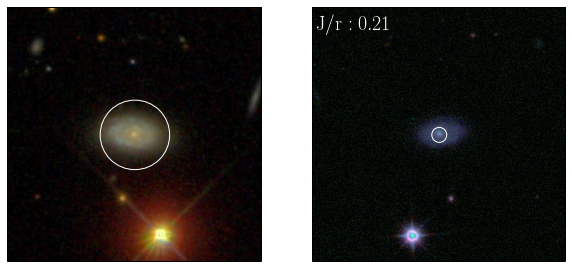

In [27]:
#gal = data[(data['J/r']<.1) & (data[u_features]>.8)][4]
f=plt.figure(figsize=(10,7))
gs=gridspec.GridSpec(1,2)
ax=plt.subplot(gs[0,0])
plt.imshow(optical_image(gal))
plt.tick_params(labelbottom='off',labelleft='off')
circle=plt.Circle((213,213),gal['RSN5_r']/(.02*gal['PETROR90_R']),fill=False,color='w')
ax.add_artist(circle)
ax=plt.subplot(gs[0,1])
plt.imshow(IR_image(gal))
plt.tick_params(labelbottom='off',labelleft='off')
ax.annotate('$\mathrm{J/r: %s}$'%round(gal['J/r'],2),fontsize=20,xy=(0.02,.97),
    xycoords='axes fraction',verticalalignment='top',color='white')
circle=plt.Circle((213,213),gal['RSN5_j']/(.02*gal['PETROR90_R']),fill=False,color='w')
ax.add_artist(circle)

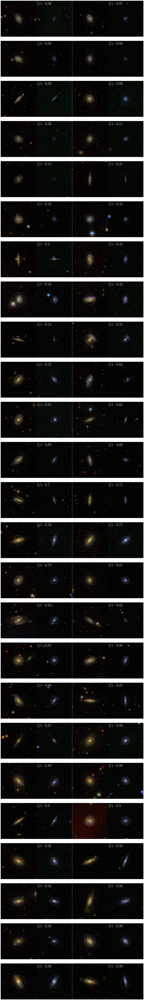

In [269]:
data_criteria = (data['RSN5_r']<2000) & (data['RSN5_j']<1000) & (data['J/r']<1)
gs=gridspec.GridSpec(25,4)
gs.update(wspace=0)
gs.update(hspace=0.01)

these_data=data[data_criteria]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
#random.seed(3)
random.shuffle(n_list)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])
    
#now we have a random list of galaxies -sort by something
indx = data.colnames.index('J/r')
random_gal_list.sort(key=itemgetter(indx))

f=plt.figure(figsize=(25,175))
n=0
for i in range(0,25):
    gal = random_gal_list[n] # random galaxy from big list 
    
    ax=plt.subplot(gs[i,0])#left-most is gz2 image
    plt.imshow(optical_image(gal))
    plt.tick_params(labelbottom='off',labelleft='off')
    circle=plt.Circle((213,213),gal['RSN5_r']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)
    
    ax = plt.subplot(gs[i,1]) #right is ukidss image
    plt.imshow(IR_image(gal))
    ax.annotate('$\mathrm{J/r: %s}$'%round(gal['J/r'],2),fontsize=38,xy=(0.02,.97),
        xycoords='axes fraction',verticalalignment='top',color='white')
    circle=plt.Circle((213,213),gal['RSN5_j']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)
    plt.tick_params(labelbottom='off',labelleft='off')
    
    #2nd column
    gal = random_gal_list[n+1] # random galaxy from big list 
    
    ax=plt.subplot(gs[i,2])#left-most is gz2 image
    plt.imshow(optical_image(gal))
    plt.tick_params(labelbottom='off',labelleft='off')
    circle=plt.Circle((213,213),gal['RSN5_r']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)

    plt.axvline(x=0,c='w',lw=3)
    
    ax = plt.subplot(gs[i,3]) #right is ukidss image
    plt.imshow(IR_image(gal))
    ax.annotate('$\mathrm{J/r: %s}$'%round(gal['J/r'],2),fontsize=38,xy=(0.02,.97),
        xycoords='axes fraction',verticalalignment='top',color='white')
    circle=plt.Circle((213,213),gal['RSN5_j']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)
    plt.tick_params(labelbottom='off',labelleft='off')
    
    
    n+=2
        

plt.savefig('figures/SN_compared.pdf')


In [13]:
data = Table.read('data_SN_2.fits')


In [14]:
c_raw=Column([float(j)/r for j,r in zip(data['RSN5_j'],data['RSN5_r'])],name='J/r_raw')
c_corrected = Column([float(j)/r for j,r in zip(data['RSN5_j'],data['RSN5_r'])],name='J/r')
data.add_columns([c_raw,c_corrected])
for gal in data:
    if gal['RSN5_r']>=1000: #change J/r to use petro instead of 1000,2000
        gal['J/r']=gal['RSN5_j']/gal['PETROR90_R']

In [16]:
data=data[(data['RSN5_r']>0) & (data['RSN5_j']>0) & (data['RSN5_j']<1000)]
len(data)

10171

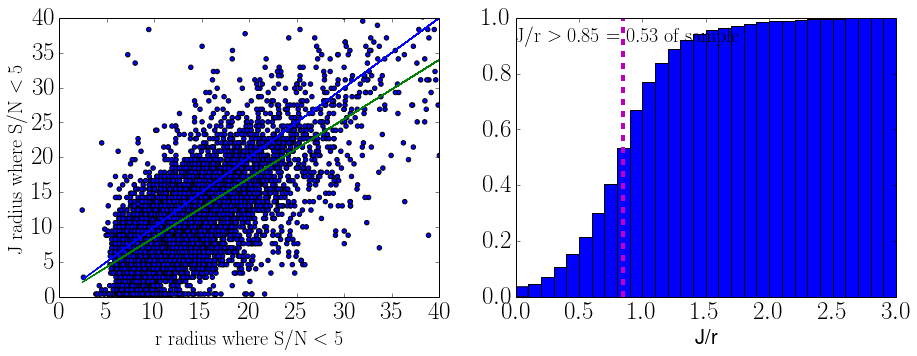

In [96]:
cut=.85
f=plt.figure(figsize=(15,5))
gs = gridspec.GridSpec(1,2)
ax=plt.subplot(gs[0,0])
plt.scatter(data['RSN5_r'],data['RSN5_j'])
plt.plot(data['RSN5_r'],data['RSN5_r'])
plt.plot(data['RSN5_r'],cut*data['RSN5_r'])
plt.xlabel('$\mathrm{r~radius~where~S/N < 5}$',fontsize=20)
plt.ylabel('$\mathrm{J~radius~where~S/N < 5}$',fontsize=20)
plt.xlim(0,40)
plt.ylim(0,40)
ax=plt.subplot(gs[0,1])
plt.hist(data['J/r'],range=(0,3),bins=30,cumulative=True,normed=True)
plt.xlabel('J/r',fontsize=20)
plt.axvline(cut,ls='dashed',lw=4,c='m')
ax.annotate('$\mathrm{J/r>%s=%s~of~sample}$'%(round(cut,2),round(len(data[data['J/r']>cut])*1./len(data),2)),fontsize=20,xy=(0,.97),
    xycoords='axes fraction',verticalalignment='top')


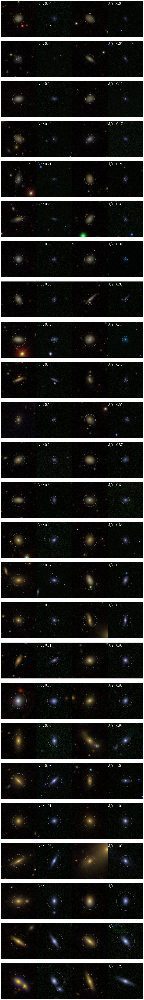

In [74]:
data_criteria = (data['RSN5_r']<1000) & (data['RSN5_j']<1000)
gs=gridspec.GridSpec(25,4)
gs.update(wspace=0)
gs.update(hspace=0.01)


    #25 bins of J/r
Jr_hi=1.2
Jr_edges = np.linspace(0,Jr_hi,25)
width = Jr_edges[1]/2
Jr_centers = Jr_edges + width



f=plt.figure(figsize=(25,175))
for i in range(0,25):
    this_Jr_bin = data[(data['J/r']>(Jr_centers[i]-width)) & (data['J/r']<(Jr_centers[i]+width)) & data_criteria]
    gal = this_Jr_bin[0] #first galaxy from this list 
    
    ax=plt.subplot(gs[i,0])#left-most is gz2 image
    plt.imshow(optical_image(gal))
    plt.tick_params(labelbottom='off',labelleft='off')
    circle=plt.Circle((213,213),gal['RSN5_r']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)
    
    ax = plt.subplot(gs[i,1]) #right is ukidss image
    plt.imshow(IR_image(gal))
    ax.annotate('$\mathrm{J/r: %s}$'%round(gal['J/r'],2),fontsize=38,xy=(0.02,.97),
        xycoords='axes fraction',verticalalignment='top',color='white')
    circle=plt.Circle((213,213),gal['RSN5_j']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)
    plt.tick_params(labelbottom='off',labelleft='off')
    
    #2nd column
    this_Jr_bin = data[(data['J/r']>(Jr_centers[i]-width)) & (data['J/r']<(Jr_centers[i]+width)) & data_criteria]
    gal = this_Jr_bin[1] #second galaxy from this list 
    
    ax=plt.subplot(gs[i,2])#left-most is gz2 image
    plt.imshow(optical_image(gal))
    plt.tick_params(labelbottom='off',labelleft='off')
    circle=plt.Circle((213,213),gal['RSN5_r']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)

    plt.axvline(x=0,c='w',lw=3)
    
    ax = plt.subplot(gs[i,3]) #right is ukidss image
    plt.imshow(IR_image(gal))
    ax.annotate('$\mathrm{J/r: %s}$'%round(gal['J/r'],2),fontsize=38,xy=(0.02,.97),
        xycoords='axes fraction',verticalalignment='top',color='white')
    circle=plt.Circle((213,213),gal['RSN5_j']/(.02*gal['PETROR90_R']),fill=False,color='w',alpha=.5)
    ax.add_artist(circle)
    plt.tick_params(labelbottom='off',labelleft='off')
    
    

plt.savefig('figures/SN_compared_2.pdf')


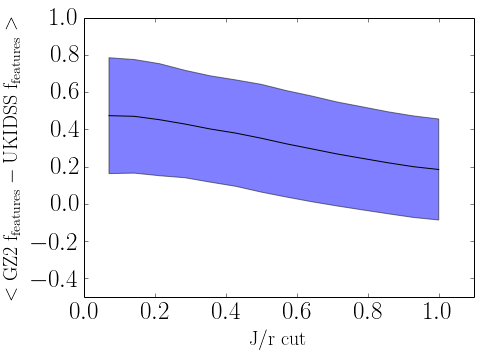

In [20]:
u_features = 't00_smooth_or_features_a1_features_debiased_rh_ukidss'
g_features = 't01_smooth_or_features_a02_features_or_disk_debiased_gz2'

Jr=np.linspace(0,1,15)
avg=[]
err = []
for x in Jr:
    avg.append(np.mean(data[data['J/r']<x][g_features]-data[data['J/r']<x][u_features]))
    err.append(np.std(data[data['J/r']<x][g_features]-data[data['J/r']<x][u_features]))

f=plt.figure(figsize=(7,5))
y1 = [a+e for a,e in zip(avg[1:],err[1:])]
y2 = [a-e for a,e in zip(avg[1:],err[1:])]
plt.plot(Jr[1:],avg[1:],c='k')
plt.fill_between(Jr[1:],y2,y1,alpha=.5)
plt.ylim(-.5,1)
plt.xlim(0,1.1)
plt.ylabel('$\mathrm{<GZ2~f_{features} - UKIDSS~f_{features}>}$',fontsize=20)
plt.xlabel('$\mathrm{J/r~cut}$',fontsize=20)
#make differential version of this plot!

In [86]:
u_features = 't00_smooth_or_features_a1_features_debiased_rh_ukidss'
g_features = 't01_smooth_or_features_a02_features_or_disk_debiased_gz2'

Jr_hi=2
Jr_edges = np.linspace(0,Jr_hi,20)
width = Jr_edges[1]/2
Jr_centers = Jr_edges + width
avg=[]
err = []
for x in Jr_centers:
    Jr_range = (data['J/r']>=(x-width)) & (data['J/r']<(x+width))
    avg.append(np.mean(data[Jr_range][g_features]-data[Jr_range][u_features]))
    err.append(np.std(data[Jr_range][g_features]-data[Jr_range][u_features]))
    
hist,xedges,yedges=np.histogram2d(data['J/r'],data[g_features]-data[u_features],range=((0,Jr_hi),(-1,1)))
extent=[xedges[0], xedges[-1], yedges[0], yedges[-1]]

<matplotlib.colorbar.Colorbar instance at 0x7f9cdc2975f0>

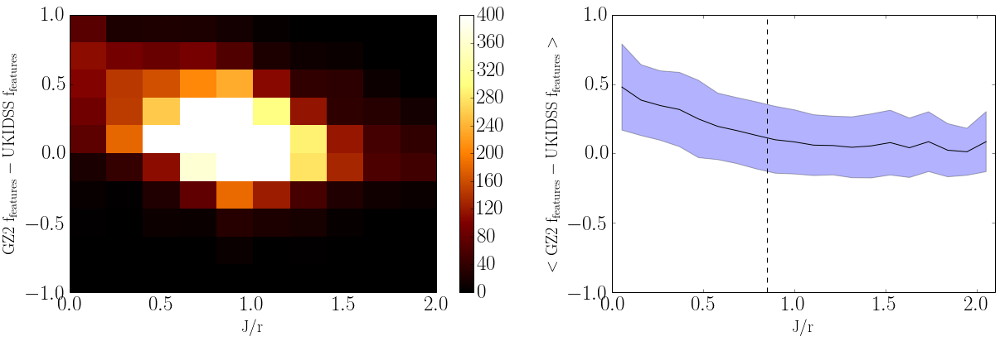

In [97]:
f=plt.figure(figsize=(20,6))
gs = gridspec.GridSpec(1,2,width_ratios=[1.2,1])

ax=plt.subplot(gs[0,1])
y1 = [a+e for a,e in zip(avg,err)]
y2 = [a-e for a,e in zip(avg,err)]
plt.plot(Jr_centers,avg,c='k')
plt.fill_between(Jr_centers,y2,y1,alpha=.3)
plt.ylim(-1,1)
plt.xlim(0,Jr_hi+.1)
plt.ylabel('$\mathrm{<GZ2~f_{features} - UKIDSS~f_{features}>}$',fontsize=20)
plt.xlabel('$\mathrm{J/r}$',fontsize=20)
plt.axvline(.85,ls='dashed',c='k')
ax=plt.subplot(gs[0,0])
plt.imshow(hist.T,origin='lower',extent=extent,interpolation='nearest',aspect='auto',cmap=plt.cm.afmhot,vmin=0,vmax=400)
plt.ylabel('$\mathrm{GZ2~f_{features} - UKIDSS~f_{features}}$',fontsize=20)
plt.xlabel('$\mathrm{J/r}$',fontsize=20)
plt.colorbar()

In [70]:
Jr_hi=1.2
Jr_edges = np.linspace(0,Jr_hi,25)
width = Jr_edges[1]/2
Jr_centers = Jr_edges + width

In [71]:
Jr_edges

array([ 0.  ,  0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,  0.35,  0.4 ,
        0.45,  0.5 ,  0.55,  0.6 ,  0.65,  0.7 ,  0.75,  0.8 ,  0.85,
        0.9 ,  0.95,  1.  ,  1.05,  1.1 ,  1.15,  1.2 ])

In [73]:
Jr_centers-width,Jr_centers+width

(array([ 0.  ,  0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,  0.35,  0.4 ,
         0.45,  0.5 ,  0.55,  0.6 ,  0.65,  0.7 ,  0.75,  0.8 ,  0.85,
         0.9 ,  0.95,  1.  ,  1.05,  1.1 ,  1.15,  1.2 ]),
 array([ 0.05,  0.1 ,  0.15,  0.2 ,  0.25,  0.3 ,  0.35,  0.4 ,  0.45,
         0.5 ,  0.55,  0.6 ,  0.65,  0.7 ,  0.75,  0.8 ,  0.85,  0.9 ,
         0.95,  1.  ,  1.05,  1.1 ,  1.15,  1.2 ,  1.25]))

In [4]:
import scipy.stats.distributions as dist

In [122]:
k=82242.
n=162514.
c=.95

In [112]:
p_lower=dist.beta.ppf((1-c)/2.,k+1,n-k+1)
p_upper = dist.beta.ppf(1-(1-c)/2.,k+1,n-k+1)

In [113]:
p_lower

0.50363014382324756

In [114]:
p_upper

0.50849159826637202

In [116]:
k/n-p_lower

0.0024308724584266583

In [117]:
p_upper-k/n

0.0024305819846978105

In [123]:
n2 = 740908.

In [124]:
n/n2

0.21934437204079318